# Seam Carving - Forward Energy Proof of Concept 

This notebook is a simple test-bed for proofing the addition of _Forward Energy_ as a replacement for the _Transport Map_ requirement in the **CS6475 Midterm Research Project**. By showing that _Forward Energy_ can be done in a relatively simple manner, we can more confidently replace the _Transport Map_ requirement with something that is conceptually easier to work with and easier for TAs to grade. In addition, the resultant replacement images are more straight-forward and we have more to choose from when updating the readme requirements for the project.

The original _Backward Energy_ requirements for **figures 5 and 8** of the original paper will remain as the first two sections of the project. They are show below in contrast to _Forward Energy_ for comparison and to ensure that the original images from the original paper can still be matched as closely as possible. It's interesting to note that in the case of Fig. 8, the original _Backward Energy_ approach is still the better approach.

The included `seamcarver.py` file contains the implementation code for a full solution of the **Midterm Research Project**. This notebook uses that implementation to produce the results below. 

The project itself is based on the following two papers. The latter paper contains the improved _Forward Energy_ concept.

- Shai Avidan and Ariel Shamir. 2007. [Seam Carving for Content-Aware Image Resizing](http://www.faculty.idc.ac.il/arik/SCWeb/imret/index.html). (2007). Retrieved September 16, 2019.
- Michael Rubinstein, Ariel Shamir, and Shai Avidan. [Improved Seam Carving for Video Retargeting](http://www.faculty.idc.ac.il/arik/SCWeb/vidret/index.html). (2008). Retreived September 16, 2019. 

In [1]:
import cv2
import seamcarver
import numpy as np
from argparse import Namespace
from IPython.display import display, Markdown

%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt

mpl.rcParams['figure.figsize'] = (10, 10)

In [2]:
def show_single_image(image, title):
    display(Markdown(f'### {title}'))
    fig, axs = plt.subplots(1, 1, figsize=(5, 5))
    axs.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)) 
    axs.set_title(title)

In [3]:
def show_images(resized, overlay, energy, title, figsize=(60, 20)):
    if resized is not None:        
        fig, axs = plt.subplots(1, 3, figsize=figsize)
        fig.subplots_adjust(top=0.75, bottom=0.25)
        axs[0].imshow(cv2.cvtColor(resized, cv2.COLOR_BGR2RGB)) 
        axs[0].set_title(f'Resized {title}', fontsize='16')
        axs[1].imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)) 
        axs[1].set_title(f'Overlay {title}', fontsize='16')
        norm_image = cv2.normalize(energy, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
        axs[2].imshow(norm_image)
        axs[2].set_title(f'Energy {title}', fontsize='16')

In [4]:
def carve_images(filename, new_width, new_height=None):
    class _args(Namespace):
        image = filename
        width = new_width
        height = new_height
        source = 'original'
        output = 'resized'
        step_fraction = 0.5
        energy = 'backward'

    original, resized_b, overlay_b = seamcarver.resize(_args)
    energy_b = seamcarver.energy(original, energy_type='backward')
    
    _args.energy = 'forward'
    original, resized_f, overlay_f = seamcarver.resize(_args)
    energy_f = seamcarver.energy(original, energy_type='forward')

    images = {}
    images['original'] = original 
    images['resized_b'] = resized_b
    images['overlay_b'] = overlay_b
    images['energy_b'] = energy_b
    images['resized_f'] = resized_f
    images['overlay_f'] = overlay_f
    images['energy_f'] = energy_f

    return images

def compare_energies(filename, width, height=None):
    display(Markdown(f'## {filename} Comparisons'))
    images = carve_images(filename, width, height)
    show_single_image(images['original'], f'{filename} Original')
    plt.show()
    display(Markdown(f'### {filename} Results'))
    display(Markdown(f'#### Backward Energy'))
    show_images(images['resized_b'], images['overlay_b'], images['energy_b'], f'{filename} (backward)')
    plt.show()
    display(Markdown(f'#### Forward Energy'))
    show_images(images['resized_f'], images['overlay_f'], images['energy_f'], f'{filename} (forward)')


## fig5.png Comparisons

Performing vertical reduction...
Performing vertical reduction...


### fig5.png Original

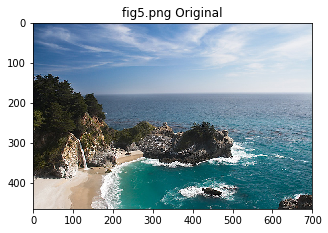

### fig5.png Results

#### Backward Energy

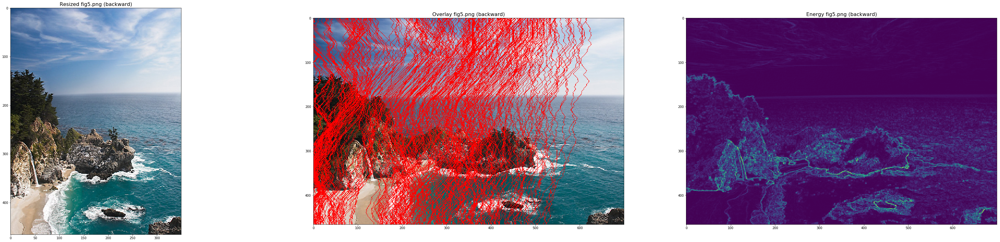

#### Forward Energy

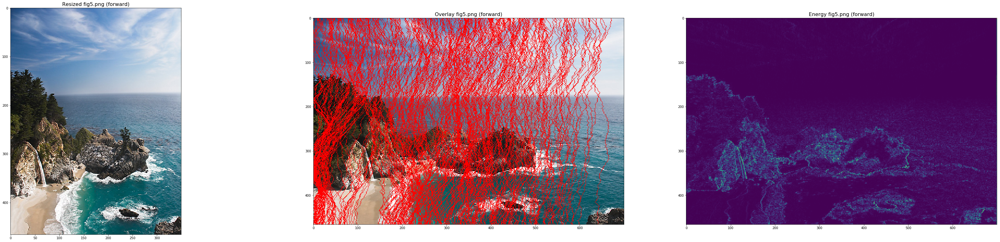

In [5]:
compare_energies('fig5.png', 350)

## fig8.png Comparisons

Performing vertical expansion...
Expanding in 1 steps...
Step 1 for 119 seams
Performing vertical expansion...
Expanding in 1 steps...
Step 1 for 119 seams


### fig8.png Original

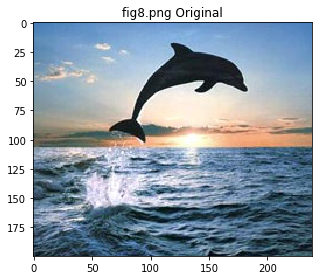

### fig8.png Results

#### Backward Energy

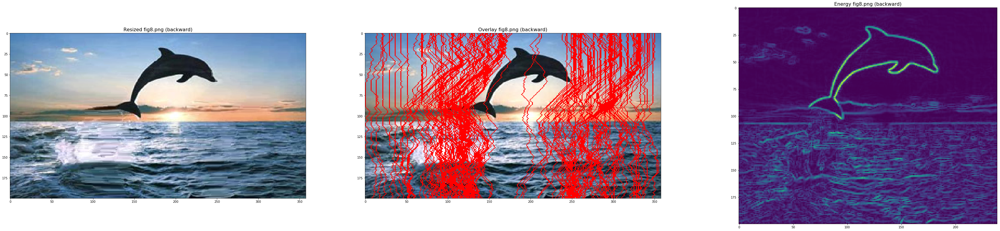

#### Forward Energy

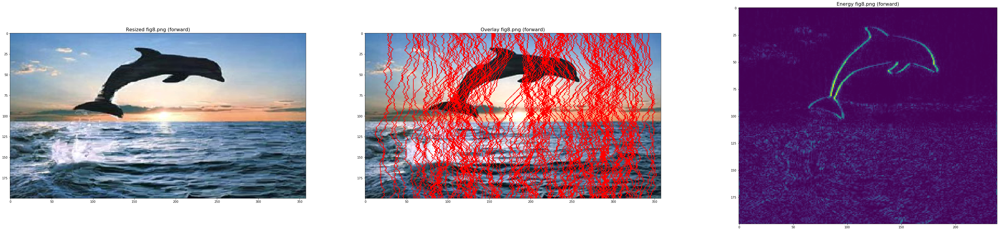

In [6]:
compare_energies('fig8.png', 358)

## bench3.png Comparisons

Performing vertical reduction...
Performing vertical reduction...


### bench3.png Original

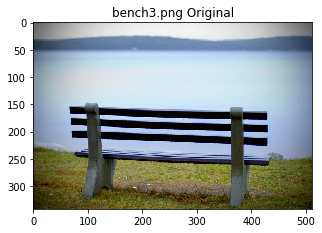

### bench3.png Results

#### Backward Energy

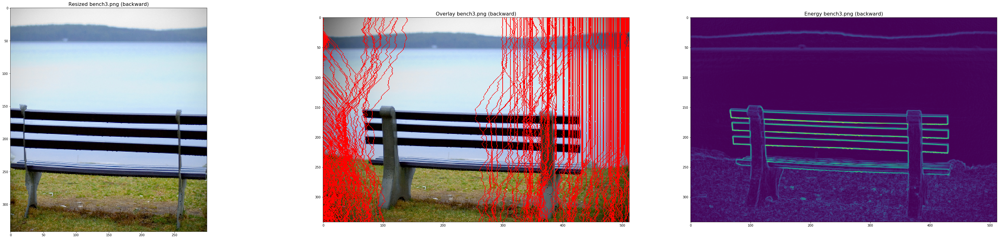

#### Forward Energy

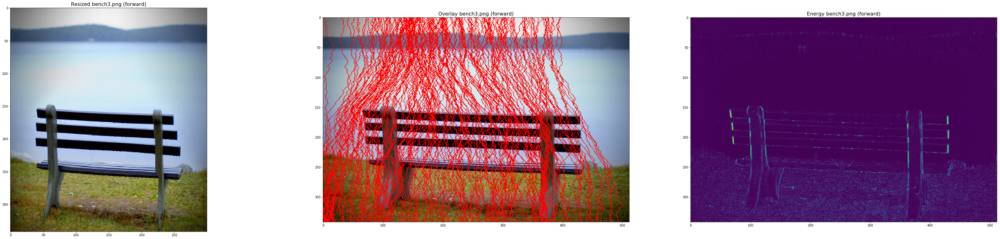

In [7]:
compare_energies('bench3.png', 300)

## rain.png Comparisons

Performing vertical reduction...
Performing vertical reduction...


### rain.png Original

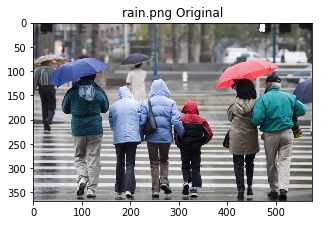

### rain.png Results

#### Backward Energy

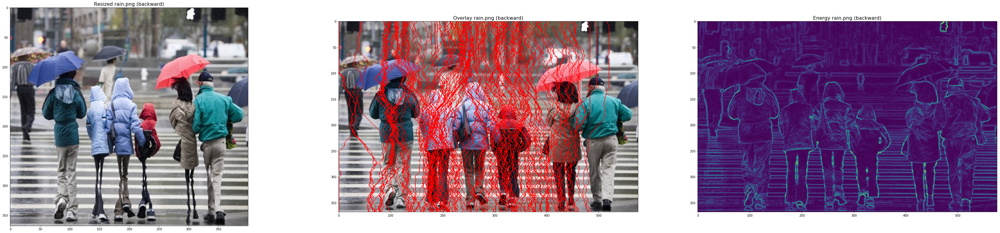

#### Forward Energy

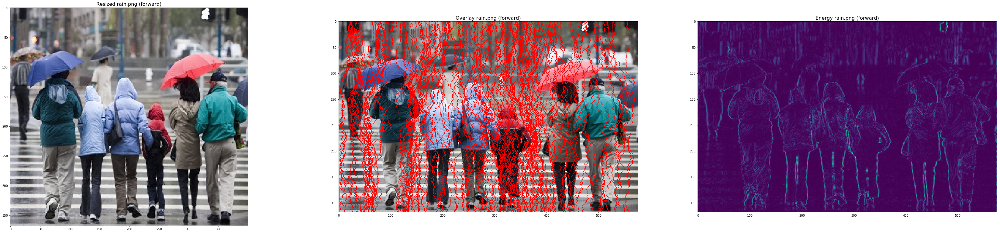

In [8]:
compare_energies('rain.png', 400)

## bench2.png Comparisons

Performing vertical reduction...
Performing vertical reduction...


### bench2.png Original

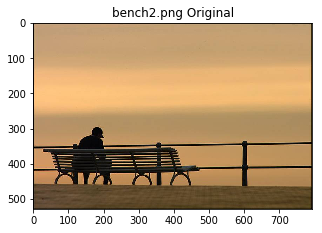

### bench2.png Results

#### Backward Energy

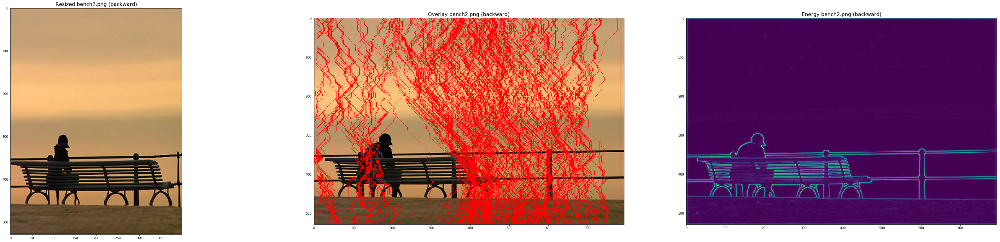

#### Forward Energy

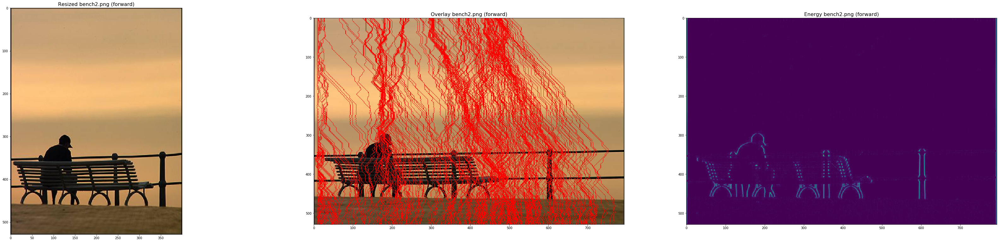

In [9]:
compare_energies('bench2.png', 400)

## ratatouille.png Comparisons

Performing vertical reduction...
Performing vertical reduction...


### ratatouille.png Original

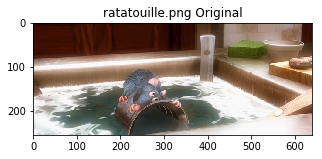

### ratatouille.png Results

#### Backward Energy

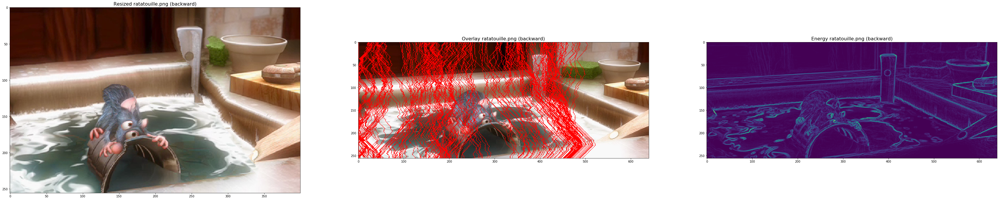

#### Forward Energy

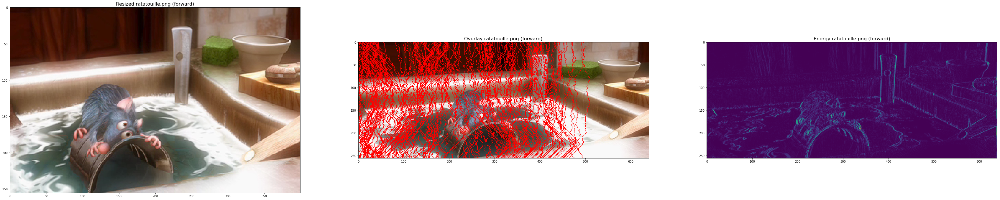

In [10]:
compare_energies('ratatouille.png', 400)

## car1.png Comparisons

Performing vertical reduction...
Performing vertical reduction...


### car1.png Original

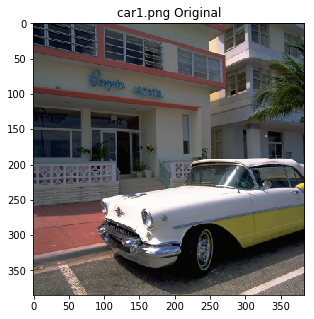

### car1.png Results

#### Backward Energy

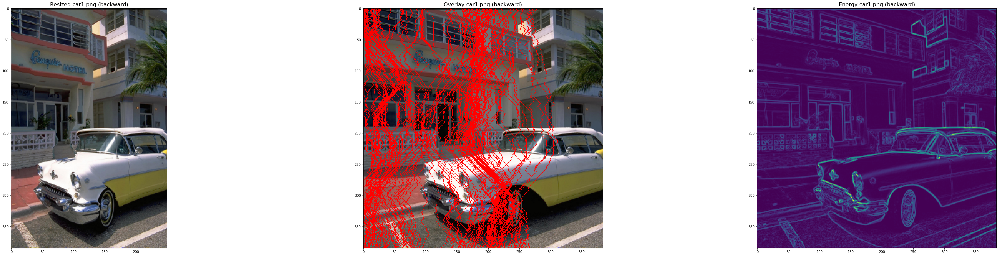

#### Forward Energy

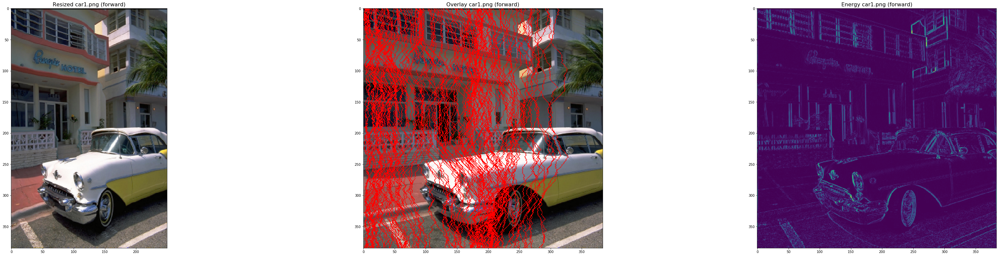

In [11]:
compare_energies('car1.png', 250)

## car1.png Comparisons

Performing vertical expansion...
Expanding in 1 steps...
Step 1 for 116 seams
Performing vertical expansion...
Expanding in 1 steps...
Step 1 for 116 seams


### car1.png Original

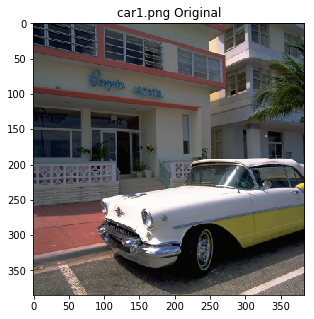

### car1.png Results

#### Backward Energy

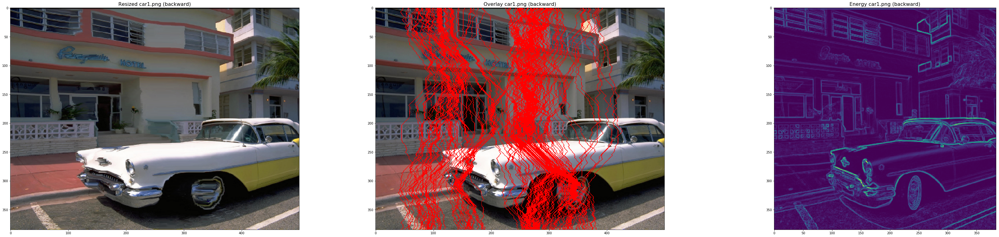

#### Forward Energy

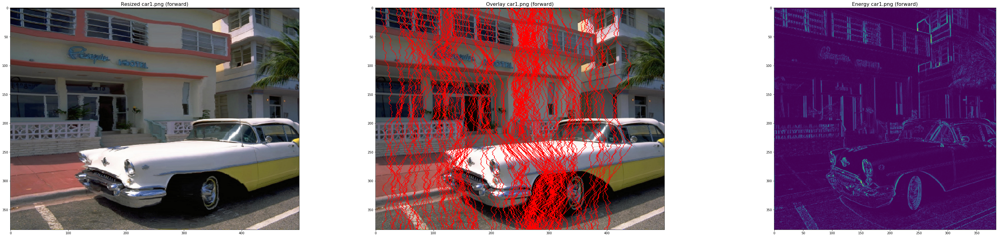

In [12]:
compare_energies('car1.png', 500)

## umbrella.jpg Comparisons

Performing vertical reduction...
Performing vertical reduction...


### umbrella.jpg Original

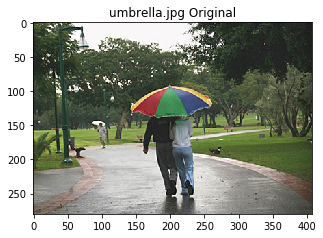

### umbrella.jpg Results

#### Backward Energy

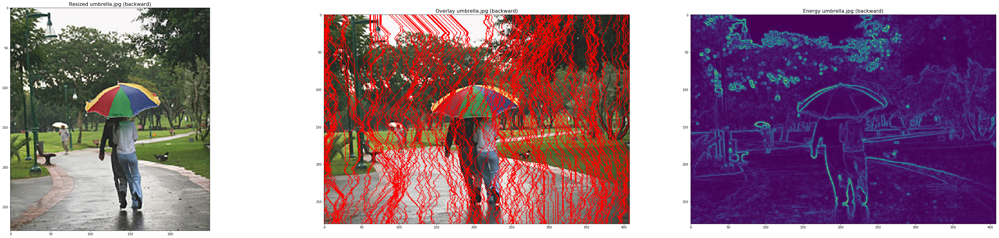

#### Forward Energy

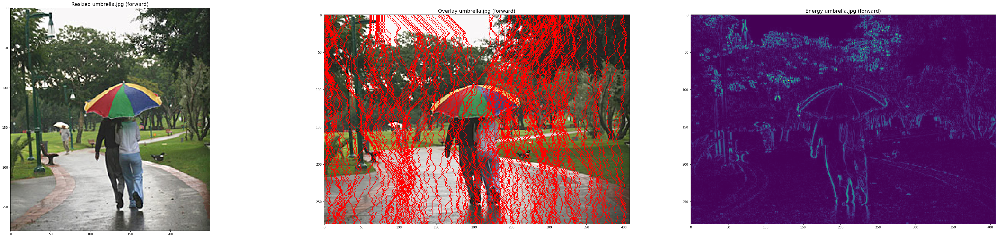

In [13]:
compare_energies('umbrella.jpg', 250)

## arch.png Comparisons

Performing vertical reduction...
Performing vertical reduction...


### arch.png Original

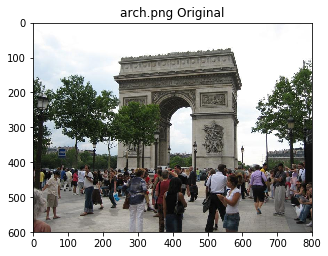

### arch.png Results

#### Backward Energy

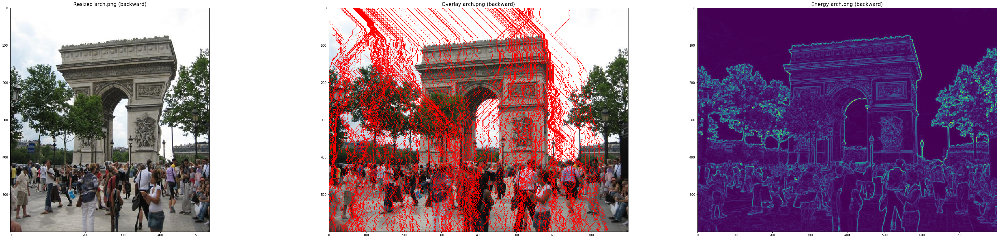

#### Forward Energy

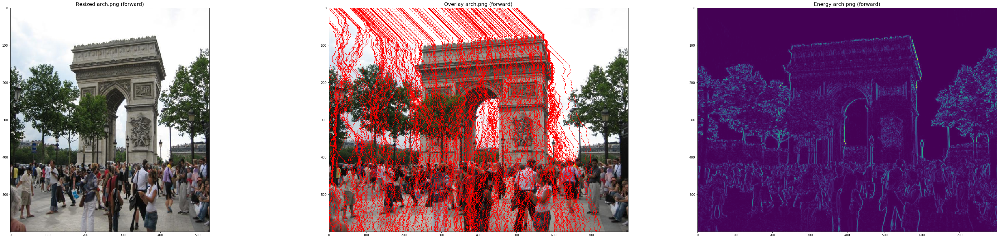

In [14]:
compare_energies('arch.png', 532)

## snow.png Comparisons

Performing vertical reduction...
Performing vertical reduction...


### snow.png Original

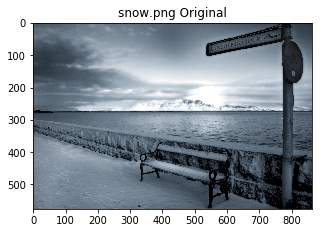

### snow.png Results

#### Backward Energy

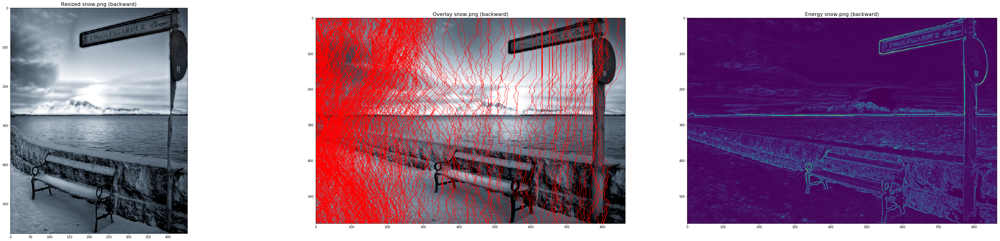

#### Forward Energy

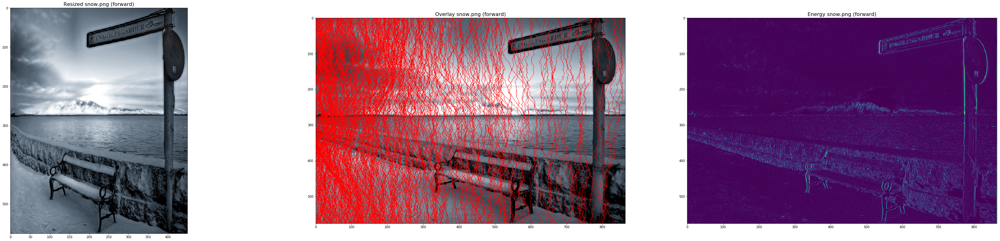

In [15]:
compare_energies('snow.png', 450)

## plier.jpg Comparisons

Performing vertical reduction...
Performing vertical reduction...


### plier.jpg Original

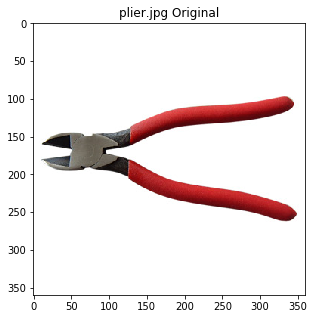

### plier.jpg Results

#### Backward Energy

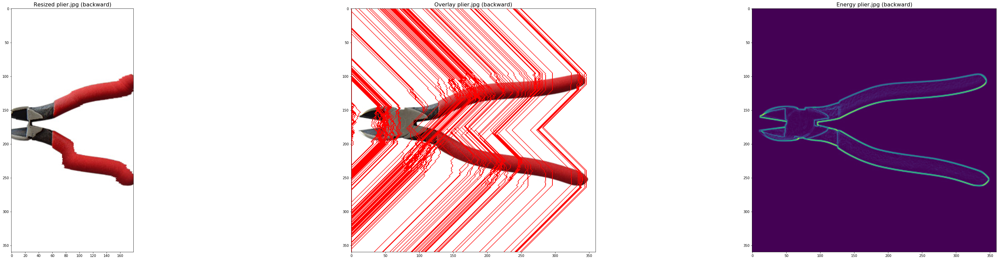

#### Forward Energy

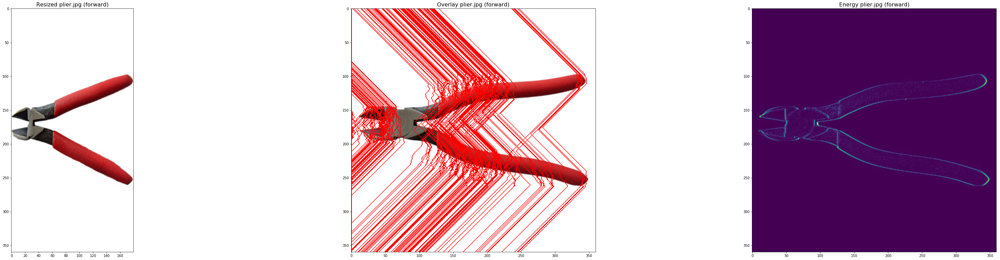

In [16]:
compare_energies('plier.jpg', 180)

In [ ]:
compare_energies('gladiator.png', None, 250)

## gladiator.png Comparisons

Performing horizontal reduction...
Performing horizontal reduction...


In [ ]:
compare_energies('vase.jpg', None, 230)

In [ ]:
compare_energies('osaka_hall.png', None, 200)